# 1. Problem Statement: 

# Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow in Australia.

# 2. Data Source:

# The dataset is taken from Kaggle and contains about 10 years of daily weather observations from many locations across Australia.

#Dataset Description:

#Number of columns: 23
Number of rows: 145460
Number of Independent Columns: 22
Number of Dependent Column: 1

# 3. Importing Libraries:

In [112]:
#The first step in any Data Analysis step is importing necessary libraries.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [4]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt # visualizing data
%matplotlib inline
import seaborn as sns

In [2]:
## Load Data Set:
# Dataset can be loaded using a method read_csv().

In [6]:
RainData = pd.read_csv(r'D:\work\python\Projects\Rain data analysis austrailia\archive\weatherAUS.csv')

In [7]:
print(RainData.shape)

(145460, 23)


# 4. Data Preprocessing:

In [8]:
RainData.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [11]:
RainData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [31]:
RainData.count().sort_values()

Sunshine          75625
Evaporation       82670
Cloud3pm          86102
Cloud9am          89572
Pressure9am      130395
Pressure3pm      130432
WindDir9am       134894
WindGustDir      135134
WindGustSpeed    135197
Humidity3pm      140953
WindDir3pm       141232
Temp3pm          141851
RainTomorrow     142193
RainToday        142199
Rainfall         142199
WindSpeed3pm     142398
Humidity9am      142806
Temp9am          143693
WindSpeed9am     143693
MinTemp          143975
MaxTemp          144199
Location         145460
Date             145460
dtype: int64

In [13]:
#check for null values

RainData.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [33]:
# Drop null Values

RainData.dropna(inplace=True)

In [65]:
# drop date column
RainData.drop(['Date'], axis=1, inplace=True)

In [66]:
RainData.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

In [67]:
RainData.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
count,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000
mean,13.464770,24.219206,2.130397,5.503135,7.735626,40.877366,15.667228,19.786778,65.874123,49.601985,1017.239505,1014.795580,4.241705,4.326515,18.204961,22.710333,0.220879,0.220259
std,6.416689,6.970676,7.014822,3.696282,3.758153,13.335232,8.317005,8.510180,18.513289,20.197040,6.909357,6.870892,2.797162,2.647251,6.567991,6.836543,0.414843,0.414425
min,-6.700000,4.100000,0.000000,0.000000,0.000000,9.000000,2.000000,2.000000,0.000000,0.000000,980.500000,977.100000,0.000000,0.000000,-0.700000,3.700000,0.000000,0.000000
25%,8.600000,18.700000,0.000000,2.800000,5.000000,31.000000,9.000000,13.000000,55.000000,35.000000,1012.700000,1010.100000,1.000000,2.000000,13.100000,17.400000,0.000000,0.000000
50%,13.200000,23.900000,0.000000,5.000000,8.600000,39.000000,15.000000,19.000000,67.000000,50.000000,1017.200000,1014.700000,5.000000,5.000000,17.800000,22.400000,0.000000,0.000000
75%,18.400000,29.700000,0.600000,7.400000,10.700000,48.000000,20.000000,26.000000,79.000000,63.000000,1021.800000,1019.400000,7.000000,7.000000,23.300000,27.900000,0.000000,0.000000
max,31.400000,48.100000,206.200000,81.200000,14.500000,124.000000,67.000000,76.000000,100.000000,100.000000,1040.400000,1038.900000,8.000000,9.000000,39.400000,46.100000,1.000000,1.000000


In [68]:
RainData.describe(include=[object])

,Location,WindGustDir,WindDir9am,WindDir3pm
count,56420,56420,56420,56420
unique,26,16,16,16
top,Darwin,E,N,SE
freq,3062,4516,4967,4153


In [69]:
RainData.describe(include='all')

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
count,56420,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420,56420.000000,56420,56420,...,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000,56420.000000
unique,26,NaN,NaN,NaN,NaN,NaN,16,NaN,16,16,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Darwin,NaN,NaN,NaN,NaN,NaN,E,NaN,N,SE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,3062,NaN,NaN,NaN,NaN,NaN,4516,NaN,4967,4153,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,13.464770,24.219206,2.130397,5.503135,7.735626,NaN,40.877366,NaN,NaN,...,65.874123,49.601985,1017.239505,1014.795580,4.241705,4.326515,18.204961,22.710333,0.220879,0.220259
std,NaN,6.416689,6.970676,7.014822,3.696282,3.758153,NaN,13.335232,NaN,NaN,...,18.513289,20.197040,6.909357,6.870892,2.797162,2.647251,6.567991,6.836543,0.414843,0.414425
min,NaN,-6.700000,4.100000,0.000000,0.000000,0.000000,NaN,9.000000,NaN,NaN,...,0.000000,0.000000,980.500000,977.100000,0.000000,0.000000,-0.700000,3.700000,0.000000,0.000000
25%,NaN,8.600000,18.700000,0.000000,2.800000,5.000000,NaN,31.000000,NaN,NaN,...,55.000000,35.000000,1012.700000,1010.100000,1.000000,2.000000,13.100000,17.400000,0.000000,0.000000
50%,NaN,13.200000,23.900000,0.000000,5.000000,8.600000,NaN,39.000000,NaN,NaN,...,67.000000,50.000000,1017.200000,1014.700000,5.000000,5.000000,17.800000,22.400000,0.000000,0.000000
75%,NaN,18.400000,29.700000,0.600000,7.400000,10.700000,NaN,48.000000,NaN,NaN,...,79.000000,63.000000,1021.800000,1019.400000,7.000000,7.000000,23.300000,27.900000,0.000000,0.000000


In [70]:
RainData.nunique()

Location          26
MinTemp          348
MaxTemp          395
Rainfall         410
Evaporation      259
Sunshine         145
WindGustDir       16
WindGustSpeed     61
WindDir9am        16
WindDir3pm        16
WindSpeed9am      36
WindSpeed3pm      37
Humidity9am      101
Humidity3pm      101
Pressure9am      504
Pressure3pm      507
Cloud9am           9
Cloud3pm          10
Temp9am          383
Temp3pm          393
RainToday          2
RainTomorrow       2
dtype: int64

In [39]:
RainData.value_counts()

Date        Location      MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  WindGustDir  WindGustSpeed  WindDir9am  WindDir3pm  WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  Pressure9am  Pressure3pm  Cloud9am  Cloud3pm  Temp9am  Temp3pm  RainToday  RainTomorrow
2007-11-01  Canberra      8.0      24.3     0.0       3.4          6.3       NW           30.0           SW          NW          6.0           20.0          68.0         29.0         1019.7       1015.0       7.0       7.0       14.4     23.6     No         Yes             1
2014-01-23  Perth         22.7     36.2     0.0       12.0         13.1      SE           54.0           SSE         SE          11.0          22.0          52.0         29.0         1007.8       1006.0       1.0       3.0       28.2     35.9     No         No              1
2014-01-22  Woomera       21.9     32.0     0.0       20.0         2.2       SSE          50.0           SSE         SSE         31.0          15.0          39.0         28.0   

In [71]:
RainData.value_counts()/len(RainData)

Location          MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  WindGustDir  WindGustSpeed  WindDir9am  WindDir3pm  WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  Pressure9am  Pressure3pm  Cloud9am  Cloud3pm  Temp9am  Temp3pm  RainToday  RainTomorrow
AliceSprings      -5.2     19.4     0.0       4.4          10.2      ENE          33.0           W           E           9.0           17.0          17.0         16.0         1022.5       1017.4       0.0       0.0       6.0      19.0     0          0               0.000018
PerthAirport       20.3    33.7     0.0       10.2         5.2       E            57.0           NW          E           6.0           31.0          47.0         50.0         1014.2       1011.8       7.0       3.0       23.6     31.4     0          1               0.000018
                   20.2    31.2     0.2       8.2          5.5       SSW          41.0           S           S           17.0          33.0          69.0         50.0         1012.0      

# 5. Finding Categorical and Numerical Features in a Data set:

In [72]:
categorical_features = [column_name for column_name in RainData.columns if RainData[column_name].dtype == 'O']
print("Number of Categorical Features: {}".format(len(categorical_features)))
print("Categorical Features: ",categorical_features)

Number of Categorical Features: 4
Categorical Features:  ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']


In [73]:
# view the categorical variables

RainData[categorical_features].head()

,Location,WindGustDir,WindDir9am,WindDir3pm
6049,Cobar,SSW,ENE,SW
6050,Cobar,S,SSE,SSE
6052,Cobar,NNE,NNE,NNW
6053,Cobar,WNW,WNW,WSW
6054,Cobar,WNW,NW,WNW


In [74]:
numerical_features = [column_name for column_name in RainData.columns if RainData[column_name].dtype != 'O']
print("Number of Numerical Features: {}".format(len(numerical_features)))
print("Numerical Features: ",numerical_features)

Number of Numerical Features: 18
Numerical Features:  ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'RainTomorrow']


# 6.Explore RainTomorrow target variable

In [75]:
RainData['RainTomorrow'].isnull().sum()

0

In [44]:
#View number of unique values

RainData['RainTomorrow'].nunique()

2

In [45]:
#View the unique values
RainData['RainTomorrow'].unique()

array(['No', 'Yes'], dtype=object)

In [46]:
#View the frequency distribution of values

RainData['RainTomorrow'].value_counts()

No     43993
Yes    12427
Name: RainTomorrow, dtype: int64

In [47]:
#View percentage of frequency distribution of values

RainData['RainTomorrow'].value_counts()/len(RainData)

No     0.779741
Yes    0.220259
Name: RainTomorrow, dtype: float64

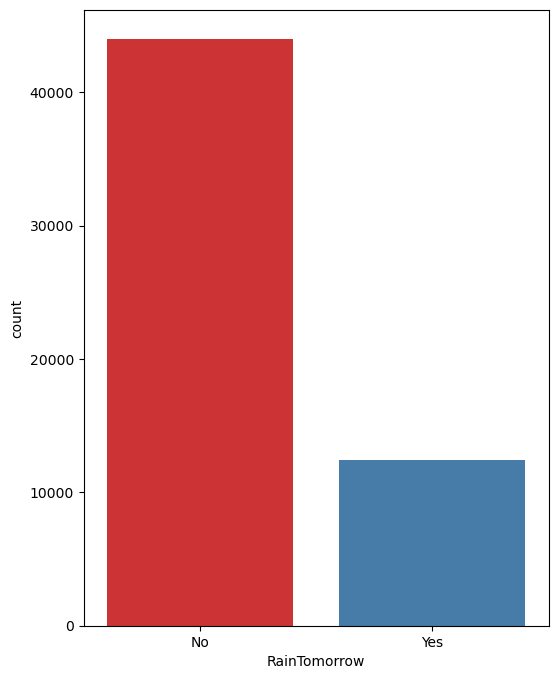

In [48]:
#Visualize frequency distribution of RainTomorrow variable

f, ax = plt.subplots(figsize=(6, 8))
ax = sns.countplot(x="RainTomorrow", data=RainData, palette="Set1")
plt.show()

# Explore RainToday variable

In [88]:
# print number of labels in RainToday variable

print('RainToday contains', len(RainData['RainToday'].unique()), 'labels')

RainToday contains 2 labels


In [89]:
# check labels in WindGustDir variable

RainData['RainToday'].unique()

array([0, 1], dtype=int64)

In [90]:
# check frequency distribution of values in WindGustDir variable

RainData.RainToday.value_counts()

0    43958
1    12462
Name: RainToday, dtype: int64

In [91]:
# let's do One Hot Encoding of RainToday variable
# get k-1 dummy variables after One Hot Encoding 
# also add an additional dummy variable to indicate there was missing data
# preview the dataset with head() method

pd.get_dummies(RainData.RainToday, drop_first=True, dummy_na=True).head()

,1.0,NaN
6049,0,0
6050,0,0
6052,0,0
6053,0,0
6054,0,0


In [92]:
# sum the number of 1s per boolean variable over the rows of the dataset
# it will tell us how many observations we have for each category

pd.get_dummies(RainData.RainToday, drop_first=True, dummy_na=True).sum(axis=0)

1.0    12462
NaN        0
dtype: int64

In [76]:
categorical_features = [column_name for column_name in RainData.columns if RainData[column_name].dtype == 'O']
RainData[categorical_features].isnull().sum()

Location       0
WindGustDir    0
WindDir9am     0
WindDir3pm     0
dtype: int64

<AxesSubplot:>

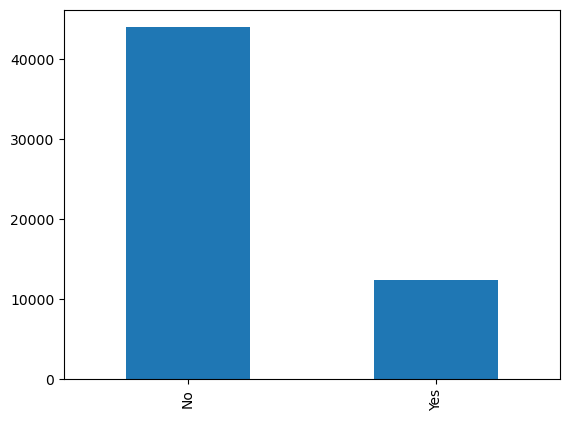

In [53]:
RainData['RainTomorrow'].value_counts().plot(kind='bar')

# 7. Exploratory Data Analysis:

<AxesSubplot:xlabel='Sunshine', ylabel='Rainfall'>

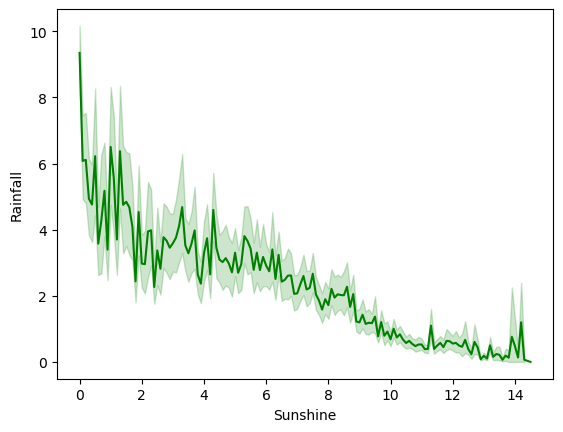

In [77]:
#Sunshine vs Rainfall:

sns.lineplot(data=RainData,x='Sunshine',y='Rainfall',color='green')

<AxesSubplot:xlabel='Sunshine', ylabel='Evaporation'>

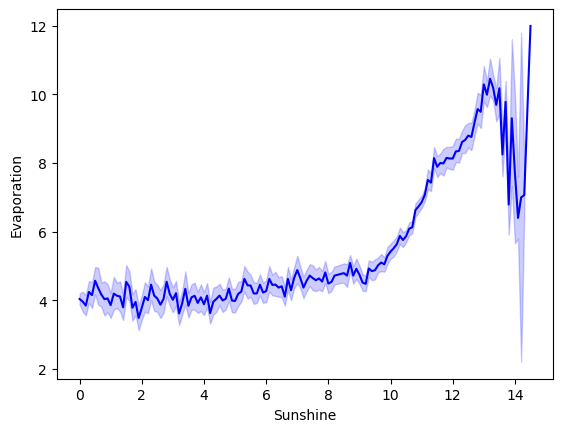

In [78]:
#Sunshine vs Evaporation:

sns.lineplot(data=RainData,x='Sunshine',y='Evaporation',color='blue')

# 8. Correlation:

<AxesSubplot:>

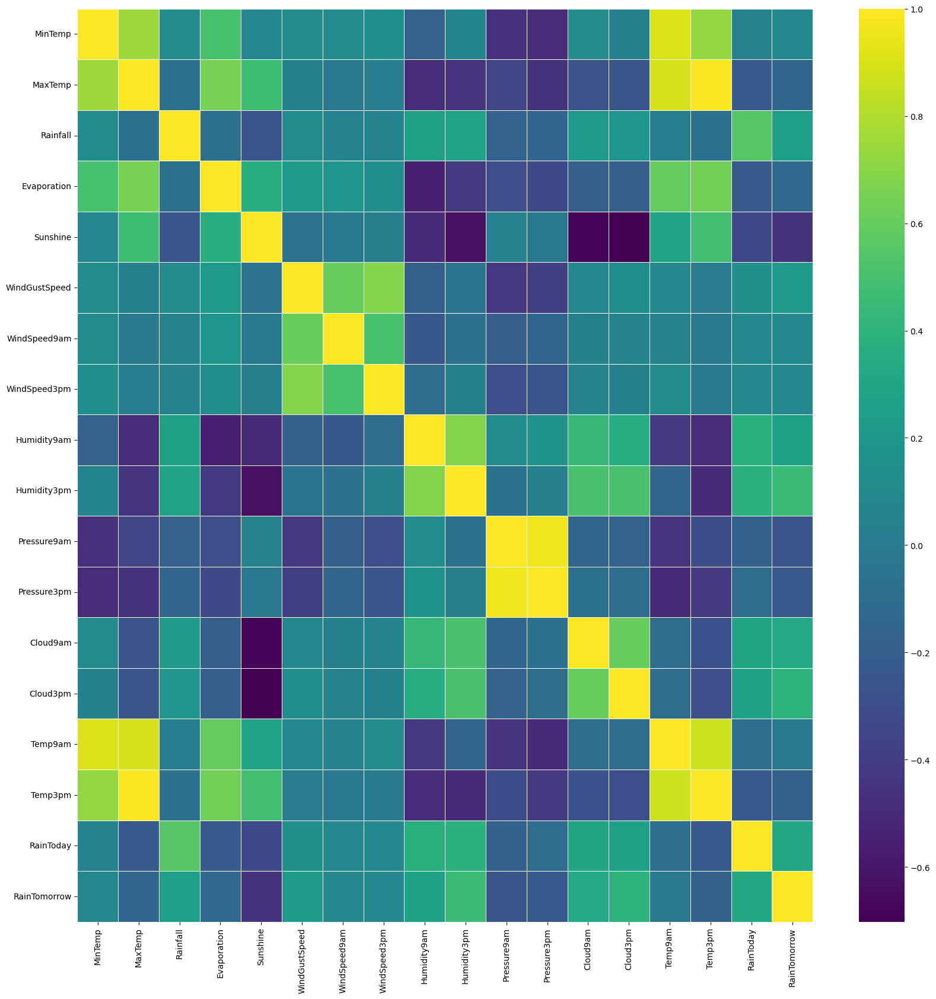

In [79]:
plt.figure(figsize=(20,20))
sns.heatmap(RainData.corr(), linewidths=0.5, annot=False, fmt=".2f", cmap = 'viridis')

In [80]:
X = RainData.drop(['RainTomorrow'],axis=1)
y = RainData['RainTomorrow']

In [81]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.2, random_state = 0)

In [93]:
print("Length of Training Data: {}".format(len(X_train)))
print("Length of Testing Data: {}".format(len(X_test)))

Length of Training Data: 45136
Length of Testing Data: 11284


Text(0, 0.5, 'WindSpeed3pm')

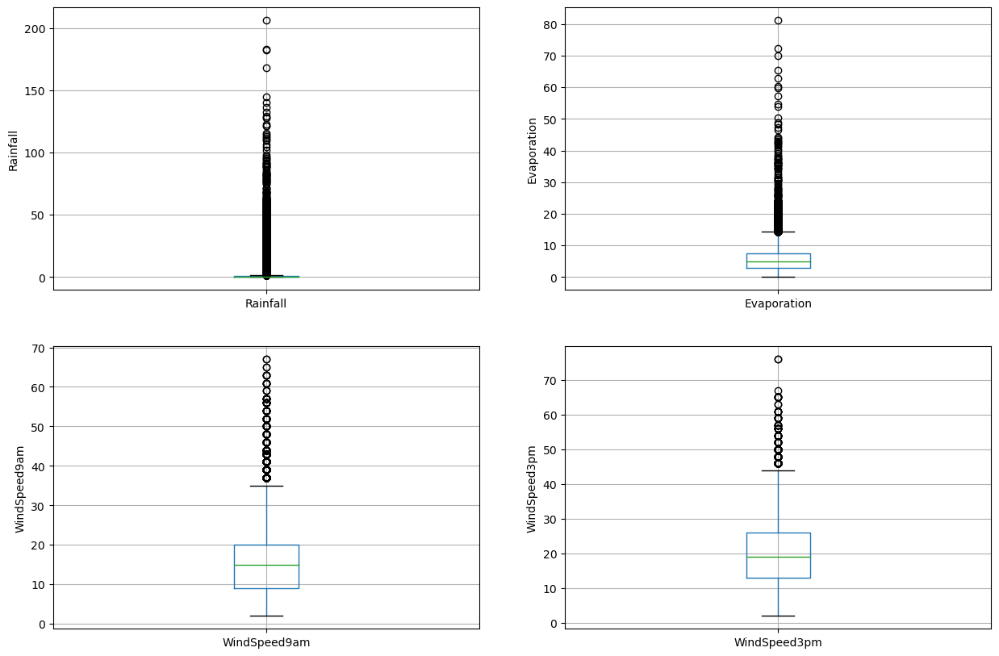

In [94]:
# draw boxplots to visualize outliers

plt.figure(figsize=(15,10))


plt.subplot(2, 2, 1)
fig = RainData.boxplot(column='Rainfall')
fig.set_title('')
fig.set_ylabel('Rainfall')


plt.subplot(2, 2, 2)
fig = RainData.boxplot(column='Evaporation')
fig.set_title('')
fig.set_ylabel('Evaporation')


plt.subplot(2, 2, 3)
fig = RainData.boxplot(column='WindSpeed9am')
fig.set_title('')
fig.set_ylabel('WindSpeed9am')


plt.subplot(2, 2, 4)
fig = RainData.boxplot(column='WindSpeed3pm')
fig.set_title('')
fig.set_ylabel('WindSpeed3pm')

#Check the distribution of variables

Text(0, 0.5, 'RainTomorrow')

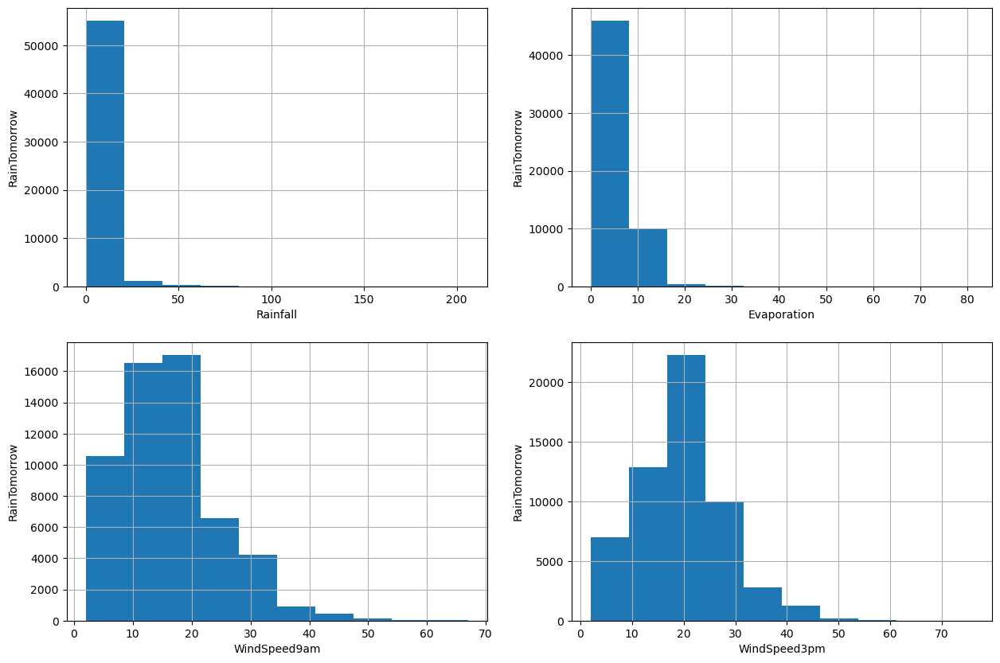

In [95]:
# plot histogram to check distribution

plt.figure(figsize=(15,10))


plt.subplot(2, 2, 1)
fig = RainData.Rainfall.hist(bins=10)
fig.set_xlabel('Rainfall')
fig.set_ylabel('RainTomorrow')


plt.subplot(2, 2, 2)
fig = RainData.Evaporation.hist(bins=10)
fig.set_xlabel('Evaporation')
fig.set_ylabel('RainTomorrow')


plt.subplot(2, 2, 3)
fig = RainData.WindSpeed9am.hist(bins=10)
fig.set_xlabel('WindSpeed9am')
fig.set_ylabel('RainTomorrow')


plt.subplot(2, 2, 4)
fig = RainData.WindSpeed3pm.hist(bins=10)
fig.set_xlabel('WindSpeed3pm')
fig.set_ylabel('RainTomorrow')

In [96]:
correlation = RainData.corr()

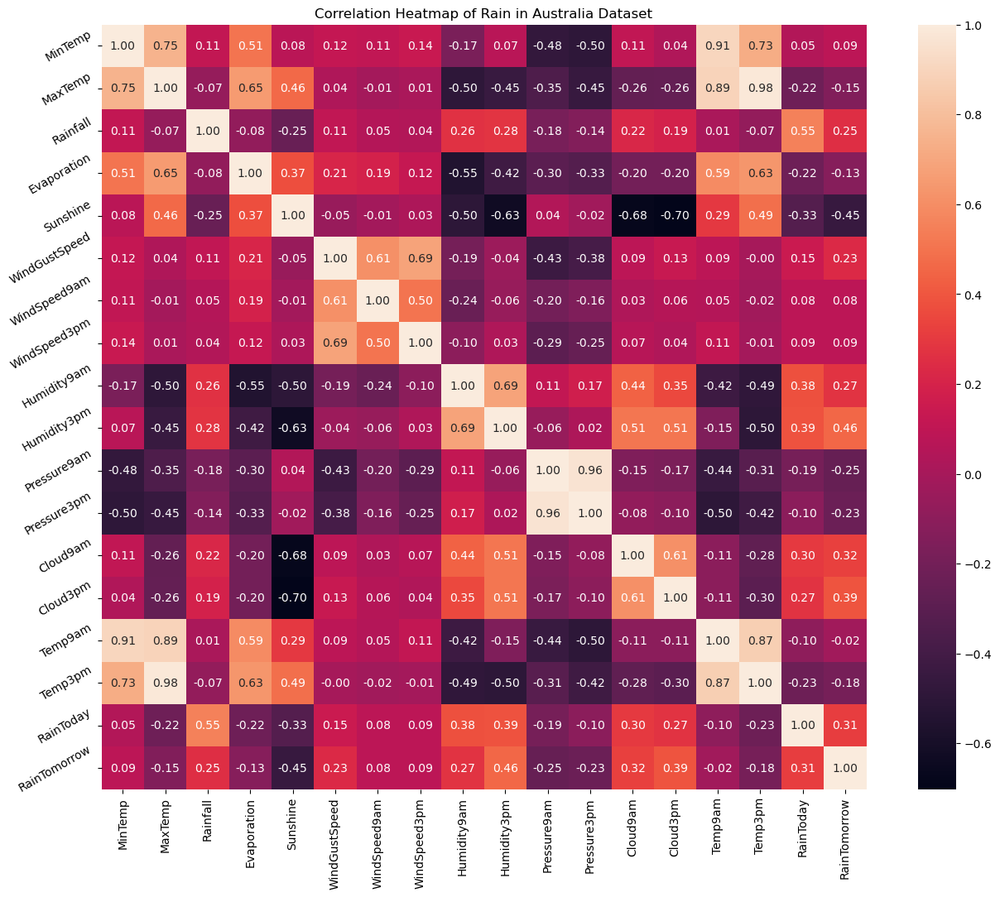

In [97]:
plt.figure(figsize=(16,12))
plt.title('Correlation Heatmap of Rain in Australia Dataset')
ax = sns.heatmap(correlation, square=True, annot=True, fmt='.2f', linecolor='white')
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_yticklabels(ax.get_yticklabels(), rotation=30)           
plt.show()

In [98]:
num_var = ['MinTemp', 'MaxTemp', 'Temp9am', 'Temp3pm', 'WindGustSpeed', 'WindSpeed3pm', 'Pressure9am', 'Pressure3pm']


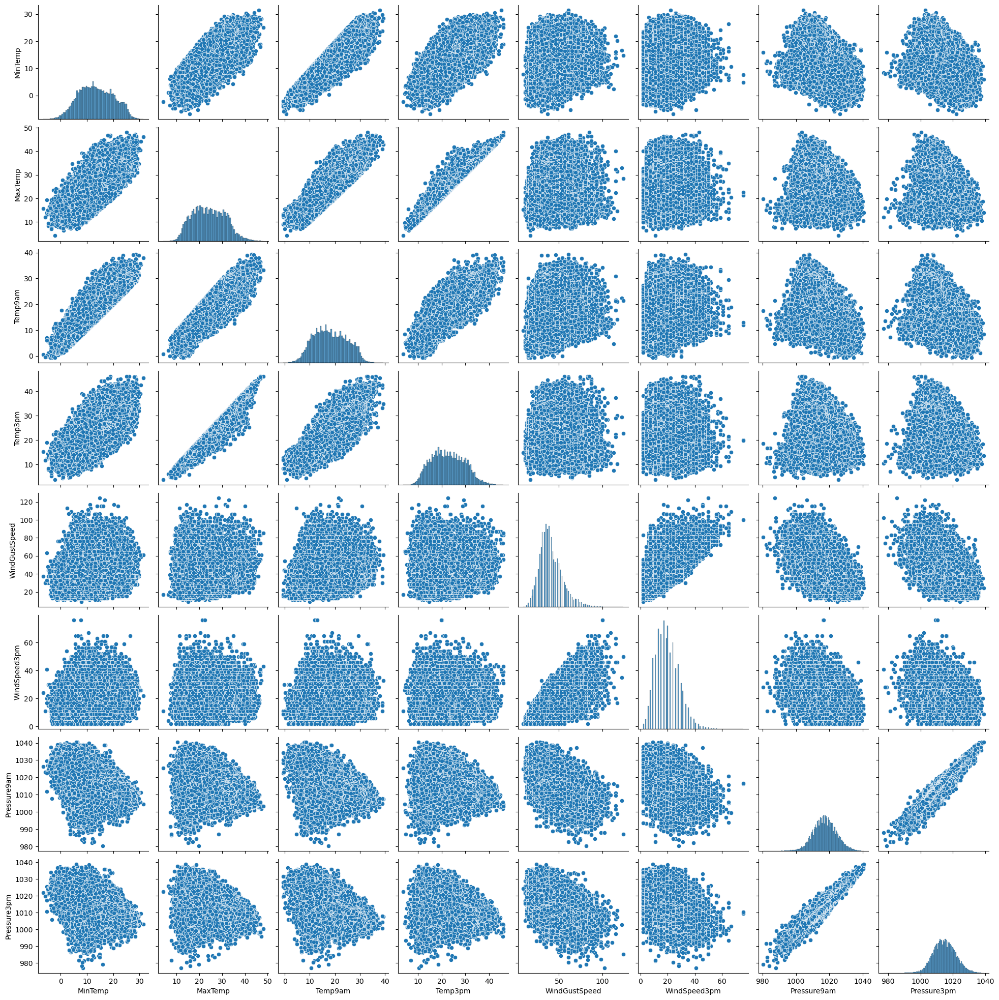

In [102]:
sns.pairplot(RainData[num_var], kind='scatter', diag_kind='hist', palette='Rainbow')
plt.show()

In [107]:

pip install pandas_profiling

Note: you may need to restart the kernel to use updated packages.


In [6]:
import ydata_profiling
import pandas as pd

In [12]:
# read the file
df = pd.read_csv(r'D:\work\python\Projects\Rain data analysis austrailia\archive\weatherAUS.csv')

# run the profile report
profile = df.profile_report(title='Pandas Profiling Report')
   


In [9]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]